# Annotations using clustering for cells for breast_s6

In [1]:
slide_id = "breast_s6"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [ ]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_processed/sdata_{slide_id}.zarr", selection=('tables',))
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_processed/sdata_breast_s6.zarr
├── Images
│     ├── 'he': DataTree[cyx] (3, 37433, 57382), (3, 18717, 28691), (3, 9359, 14346), (3, 4680, 7173), (3, 2340, 3587), (3, 1170, 1794), (3, 585, 897), (3, 293, 449)
│     └── 'morpho': DataTree[cyx] (5, 74945, 51265), (5, 37472, 25632), (5, 18736, 12816), (5, 9368, 6408), (5, 4684, 3204)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (692184, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (692184, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (692184, 5101)
      └── 'table_nuclei': AnnData (692184, 8232)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), morpho (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 692184 × 5101
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,nucleus_count,segmentation_method,region,z_level
0,aaaaaaaa-1,557,0,0,0,0,89,646,220.723758,108.871723,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
1,aaaaaaab-1,832,0,0,0,0,148,980,363.914232,91.892972,2.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
2,aaaaaaac-1,544,0,0,0,0,119,663,181.392663,114.155004,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
3,aaaaaaad-1,703,0,0,0,0,116,819,279.426885,81.010315,2.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
4,aaaaaaae-1,207,0,0,0,0,30,237,75.094846,52.607033,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
699105,aaakipnd-1,3,0,0,0,0,6,9,18.875313,18.875313,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,7.0
699106,aaakipne-1,0,0,0,0,0,1,1,12.508282,6.863750,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,7.0
699107,aaakipnf-1,2,0,0,0,0,4,6,49.897658,8.534532,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,7.0
699108,aaakipng-1,4,0,0,0,0,0,4,16.752969,8.624844,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
A2ML1,ENSG00000166535,Gene Expression,Unknown
AAMP,ENSG00000127837,Gene Expression,Unknown
AAR2,ENSG00000131043,Gene Expression,Unknown
AARSD1,ENSG00000266967,Gene Expression,Unknown
ABAT,ENSG00000183044,Gene Expression,Unknown
...,...,...,...
ZSCAN26,ENSG00000197062,Gene Expression,Unknown
ZSWIM6,ENSG00000130449,Gene Expression,Unknown
ZUP1,ENSG00000153975,Gene Expression,Unknown
ZYG11B,ENSG00000162378,Gene Expression,Unknown


In [3]:
adata_nuclei = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 530942 × 8232
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'leiden', 'log1p', 'pca', 'pca_n20_pcs16', 'pca_n20_pcs16_leiden_res0.2_colors', 'pca_n20_pcs16_leiden_res0.4_colors', 'pca_n20_pcs16_leiden_res0.6_colors', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n20_pcs16_connectivities', 'pca_n20_pcs16_distances'

In [4]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n20_pcs16_leiden_res0.2,pca_n20_pcs16_leiden_res0.4,pca_n20_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,105.394016,CXCL14 mammary basal cell,455,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,149.197018,CXCL14 mammary basal cell,626,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,110.112903,CXCL14 mammary basal cell,509,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,145.719006,CXCL14 mammary basal cell,622,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,49.897293,CXCL+ fibroblast,205,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaakipmb-1,nucleus_boundaries,morpho,aaakipmb-1,10.454180,Mast cell,11,5,3,10,10,Unknown,Unknown,normal_cell
aaakipmc-1,nucleus_boundaries,morpho,aaakipmc-1,9.482242,Dendritic cell,20,5,8,10,10,Unknown,Unknown,normal_cell
aaakipmf-1,nucleus_boundaries,morpho,aaakipmf-1,17.814421,IGFBP6+APOD+ fibroblast,33,5,8,10,10,Unknown,Unknown,normal_cell
aaakipmk-1,nucleus_boundaries,morpho,aaakipmk-1,6.953430,Mast cell,11,5,8,7,7,Unknown,Unknown,normal_cell


In [5]:
adata_nuclei.var

,mean,std
A2ML1,0.007755,0.184357
AAMP,0.094735,0.633368
AAR2,0.036772,0.393610
AARSD1,0.049671,0.448772
ABAT,0.042093,0.409650
...,...,...
ZSCAN26,0.031159,0.366238
ZSWIM6,0.036950,0.398674
ZUP1,0.028017,0.358340
ZYG11B,0.055800,0.481299


## 2. Preprocessing

<Axes: >

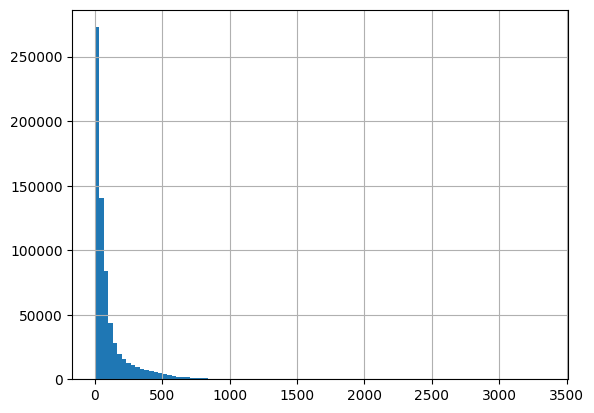

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

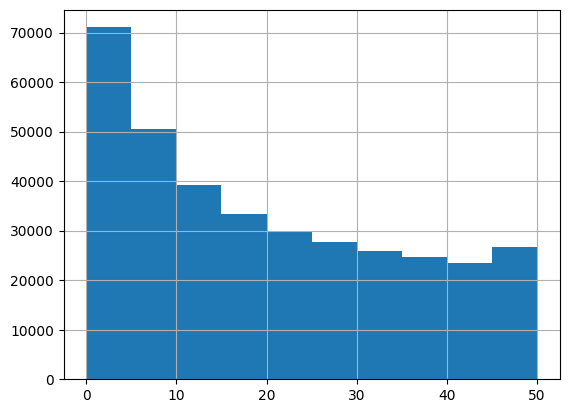

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 194154
Percentage of cells with less than 20 transcripts: 28.05%
-----
Number of cells with less than 15 transcripts: 160826
Percentage of cells with less than 15 transcripts: 23.23%
-----
Number of cells with less than 10 transcripts: 121629
Percentage of cells with less than 10 transcripts: 17.57%
-----
Number total of cells: 692184


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

562012


In [14]:
# Save and do clustering on ruche using gpu
adata_cells.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_att/adata_cells_for_gpu_clustering_{slide_id}.h5ad")

In [ ]:
# # Save the raw data
# adata_cells.layers['count'] = adata_cells.X.copy()

In [ ]:
# # Normalize
# sc.pp.normalize_total(adata_cells, target_sum=1e4)
# sc.pp.log1p(adata_cells)
# adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [ ]:
# # Scale each gene to unit variance. Clip values exceeding standard deviation 10.
# sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [ ]:
# # Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
# sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

In [ ]:
# # Contribution of single PCs to the total variance in the data
# # This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
# sc.pl.pca_variance_ratio(adata_cells, log=True)

In [ ]:
# adata_cells

In [ ]:
# # Restore X to be log norm counts
# # /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
# dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [ ]:
# # Neighborhood graph of cells using the PCA representation of the data matrix
# sc.pp.neighbors(adata_cells, n_neighbors=20, n_pcs=16, use_rep="X_pca", key_added='pca_n20_pcs16')
# # Embedding the neighborhood graph using UMAP
# sc.tl.umap(adata_cells, neighbors_key='pca_n20_pcs16')
# # Leiden clustering directly clusters the neighborhood graph of cells
# sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n20_pcs16_leiden_res0.2', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n20_pcs16_leiden_res0.4', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n20_pcs16_leiden_res0.6', neighbors_key='pca_n20_pcs16')

In [7]:
# reload adata after clustring on ruche
adata_cells = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_att/adata_cells_after_gpu_clustering_{slide_id}.h5ad")

In [8]:
adata_cells

AnnData object with n_obs × n_vars = 562012 × 5101
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'leiden', 'log1p', 'pca', 'pca_n20_pcs16', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n20_pcs16_connectivities', 'pca_n20_pcs16_distances'

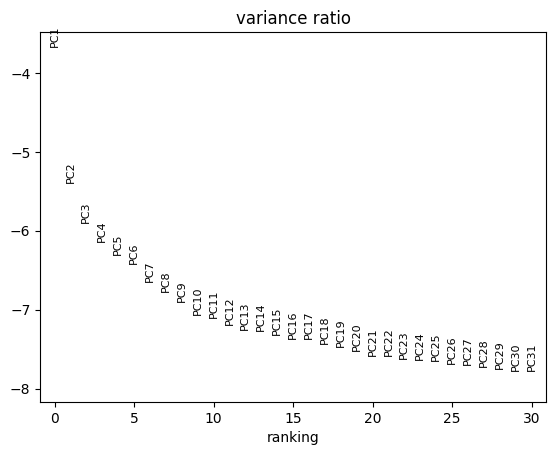

In [9]:
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [10]:
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
print(f"Sum count: {adata_cells.layers['count'].sum()}")
print(f"Sum log_norm: {adata_cells.layers['log_norm'].sum()}")
print(f"Sum X: {adata_cells.X.sum()}")

Sum count: 70102712.0
Sum log_norm: 233464016.0
Sum X: 233464016.0


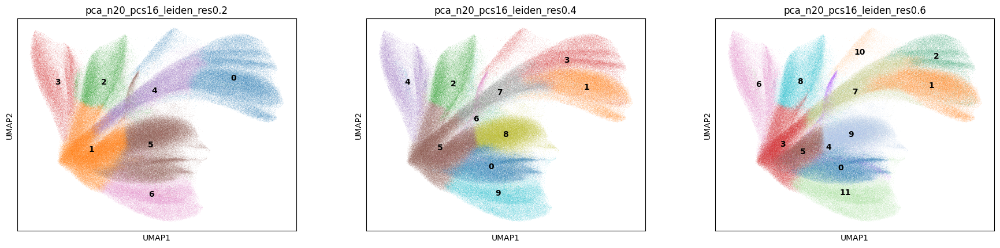

In [11]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n20_pcs16',
           color=['pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [12]:
# Number of clusters
adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].unique()

['1', '7', '9', '4', '0', ..., '11', '2', '10', '6', '8']
Length: 12
Categories (12, object): ['0', '1', '2', '3', ..., '8', '9', '10', '11']

In [13]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'

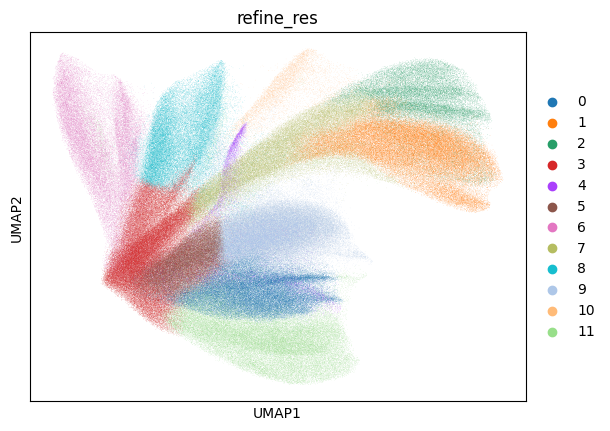

In [14]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n20_pcs16', color=['refine_res'])

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [15]:
clustering_label = 'refine_res'

In [16]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

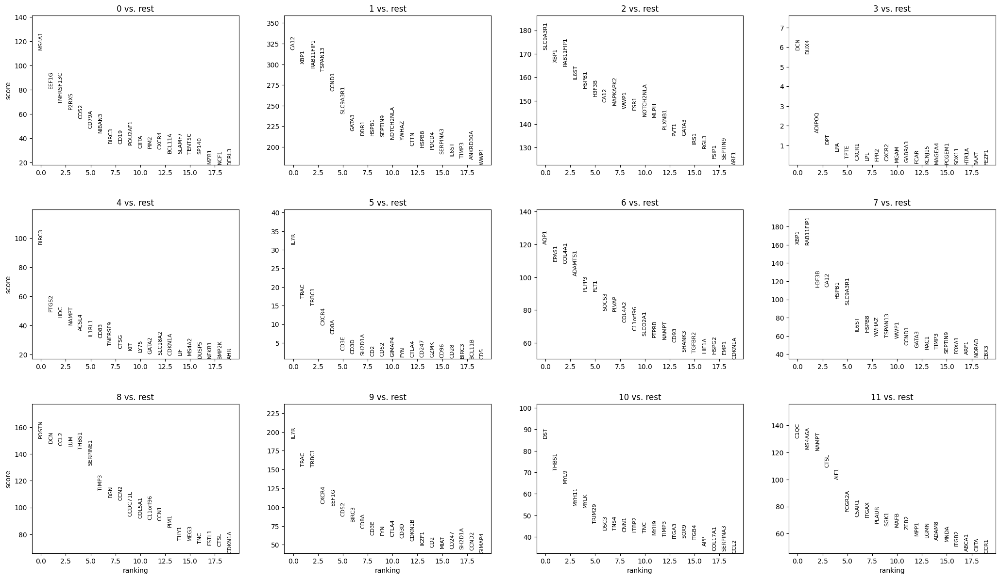

In [17]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [18]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [19]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [20]:
cluster_id = '0'

In [21]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,53.0
1,Plasma,Plasma,normal_cell,16.8
2,T,T,normal_cell,12.6
3,Unknown,Unknown,normal_cell,9.9
4,NA,NA,NA,3.2


In [22]:
top_ranked_genes[cluster_id]

0        MS4A1
1        EEF1G
2    TNFRSF13C
3        P2RX5
4         CD52
5        CD79A
6       NIBAN3
Name: 0, dtype: object

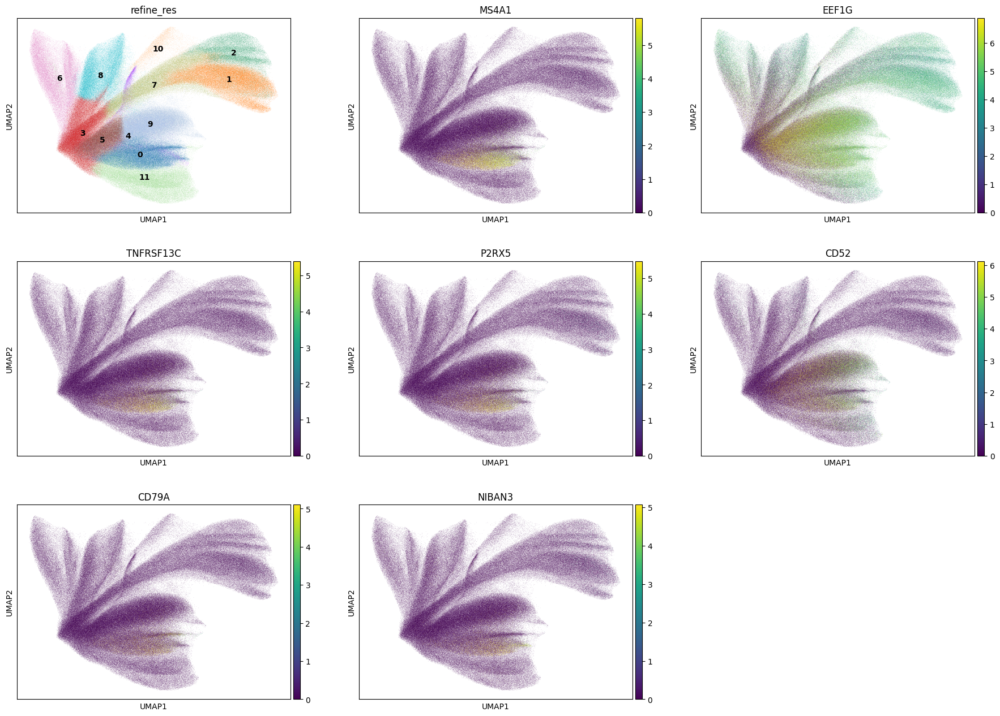

In [23]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [24]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 57303
Percentage of cells in cluster 0: 10.2


In [25]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.2. Cluster 1

In [26]:
cluster_id = '1'

In [27]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Breast_epithelial_cell,cancer_cell,98.7
1,Unknown,Unknown,normal_cell,0.8
2,T,T,normal_cell,0.2
3,NA,NA,NA,0.1
4,Fibroblast,CAF,normal_cell,0.1


In [28]:
top_ranked_genes[cluster_id]

0         CA12
1         XBP1
2    RAB11FIP1
3      TSPAN13
4        CCND1
5     SLC9A3R1
6        GATA3
Name: 1, dtype: object

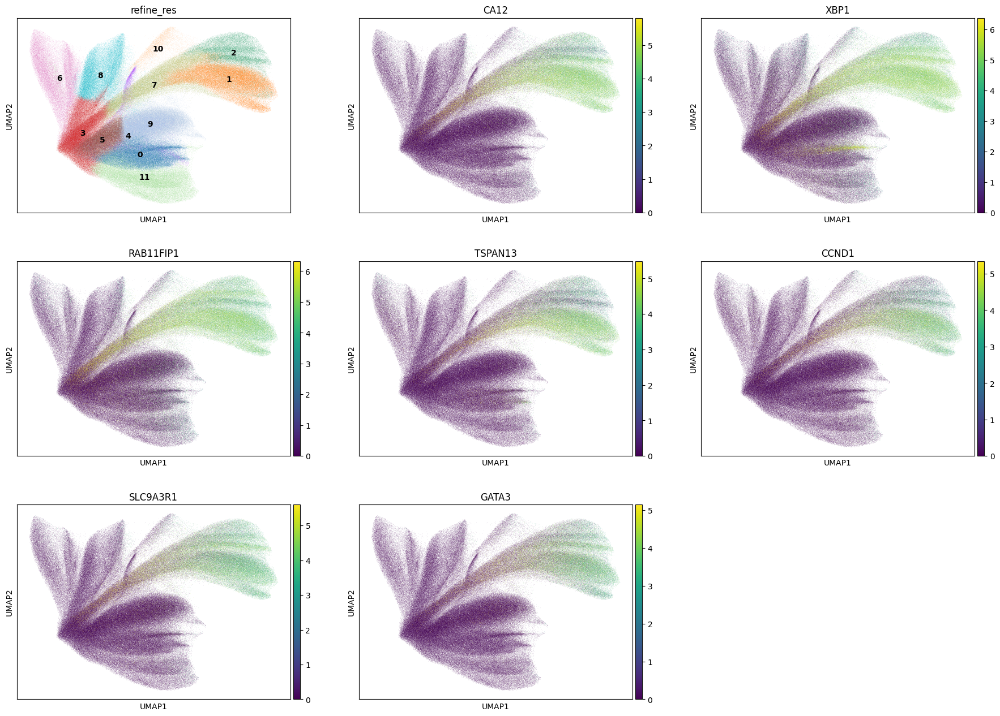

In [29]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [30]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 62248
Percentage of cells in cluster 1: 11.1


In [31]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Breast_epithelial_cell'

### 5.3. Cluster 2

In [32]:
cluster_id = '2'

In [33]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Breast_epithelial_cell,cancer_cell,99.7
1,Unknown,Unknown,normal_cell,0.2
2,Fibroblast,Fibroblast,normal_cell,0.1
3,T,T,normal_cell,0.0
4,NA,NA,NA,0.0


In [34]:
top_ranked_genes[cluster_id]

0     SLC9A3R1
1         XBP1
2    RAB11FIP1
3        IL6ST
4        HSPB1
5        H3F3B
6         CA12
Name: 2, dtype: object

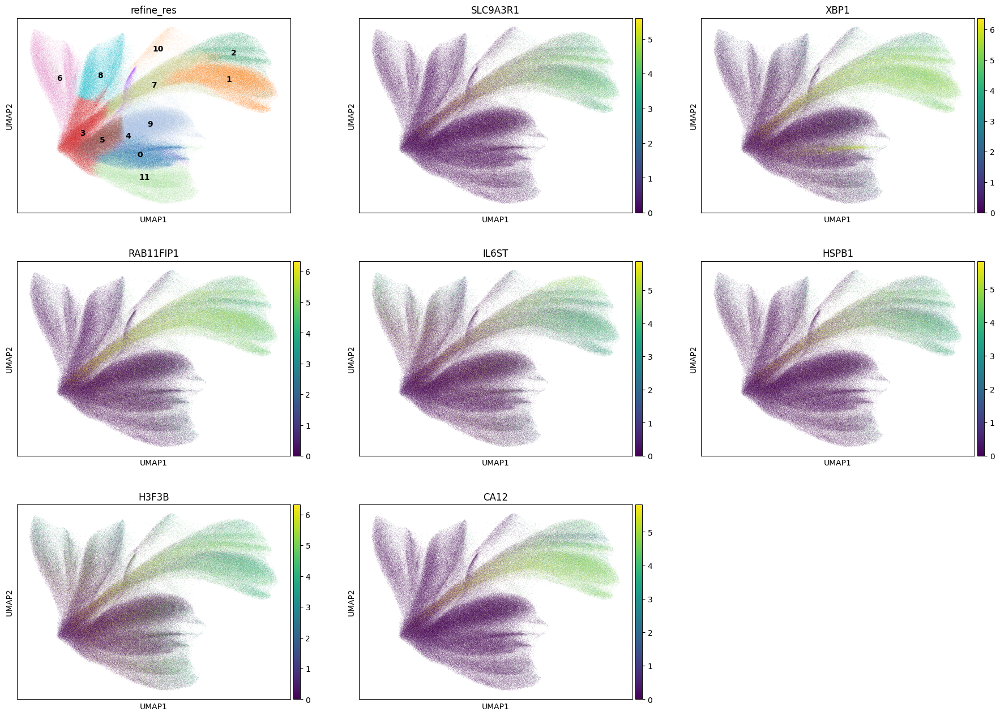

In [35]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [36]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 29069
Percentage of cells in cluster 2: 5.2


In [37]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Breast_epithelial_cell'

### 5.4. Cluster 3

In [38]:
cluster_id = '3'

In [39]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Unknown,Unknown,normal_cell,44.0
1,NA,NA,NA,32.0
2,Fibroblast,CAF,normal_cell,13.0
3,Endothelial,Endothelial,normal_cell,4.9
4,T,T,normal_cell,2.9


In [40]:
top_ranked_genes[cluster_id]

0       DCN
1      DUX4
2    ADIPOQ
3       DPT
4       LPA
5      TPTE
6     CXCR1
Name: 3, dtype: object

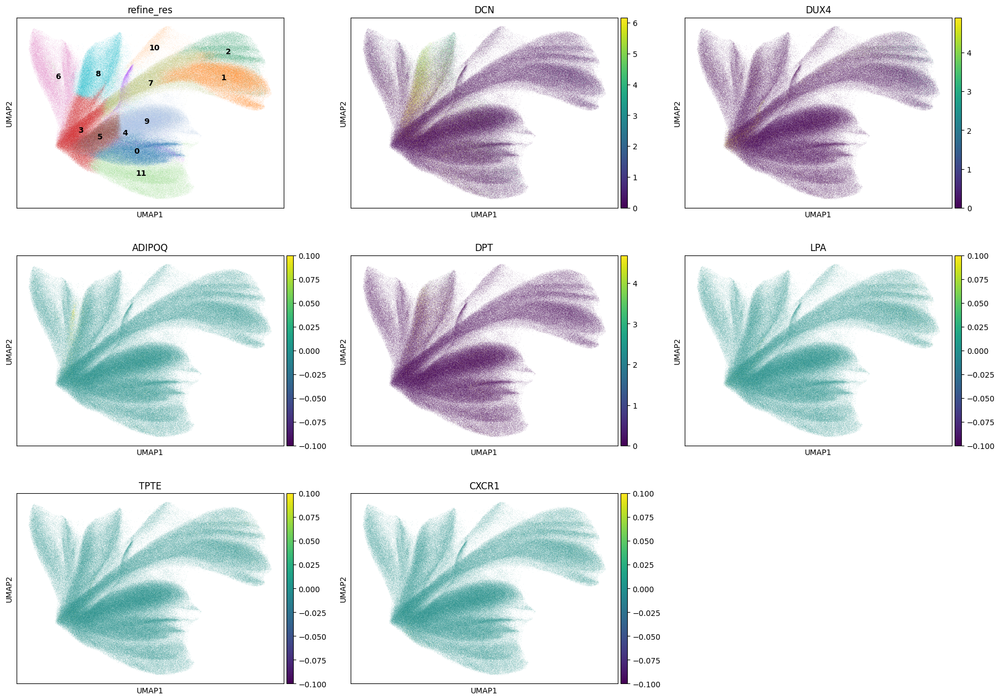

In [41]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [42]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 81623
Percentage of cells in cluster 3: 14.5


In [43]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.5. Cluster 4

In [44]:
cluster_id = '4'

In [45]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,42.7
1,T,T,normal_cell,29.2
2,Unknown,Unknown,normal_cell,15.6
3,NA,NA,NA,8.0
4,Fibroblast,CAF,normal_cell,1.4


In [46]:
top_ranked_genes[cluster_id]

0     BIRC3
1     PTGS2
2       HDC
3     NAMPT
4     ACSL4
5    IL1RL1
6      CD83
Name: 4, dtype: object

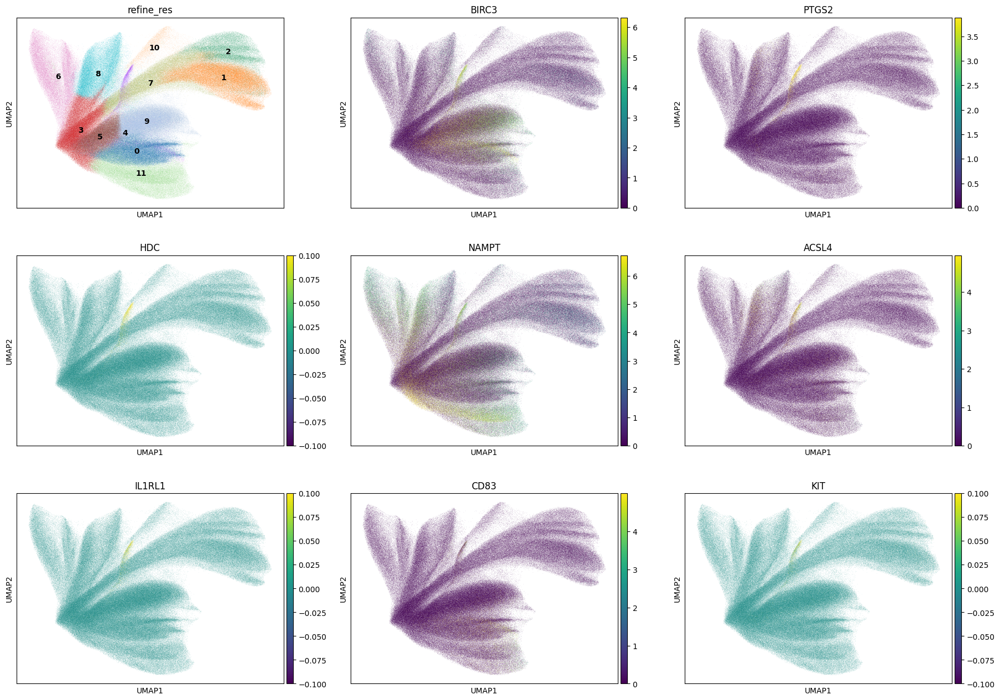

In [49]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7]+['KIT'], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [48]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 9647
Percentage of cells in cluster 4: 1.7


In [50]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.6. Cluster 5

In [51]:
cluster_id = '5'

In [52]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Unknown,Unknown,normal_cell,58.9
1,NA,NA,NA,24.0
2,T,T,normal_cell,8.8
3,B,B,normal_cell,2.9
4,Plasma,Plasma,normal_cell,1.8


In [53]:
top_ranked_genes[cluster_id]

0     IL7R
1     TRAC
2    TRBC1
3    CXCR4
4     CD8A
5     CD3E
6     CD3D
Name: 5, dtype: object

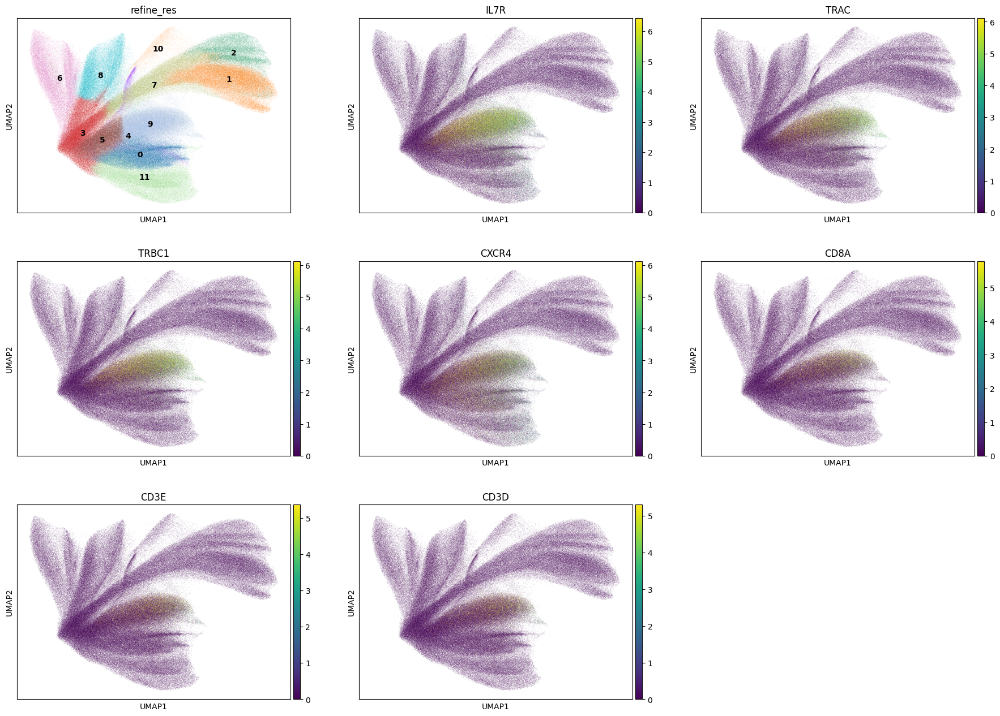

In [54]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [55]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 41860
Percentage of cells in cluster 5: 7.4


In [56]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.7. Cluster 6

In [57]:
cluster_id = '6'

In [58]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Angiogenesis_endothelial,normal_cell,45.2
1,Endothelial,Endothelial,normal_cell,32.8
2,NA,NA,NA,7.4
3,Unknown,Unknown,normal_cell,7.3
4,Fibroblast,CAF,normal_cell,3.6


In [59]:
top_ranked_genes[cluster_id]

0       AQP1
1      EPAS1
2     COL4A1
3    ADAMTS1
4      PLPP3
5       FLT1
6      SOCS3
Name: 6, dtype: object

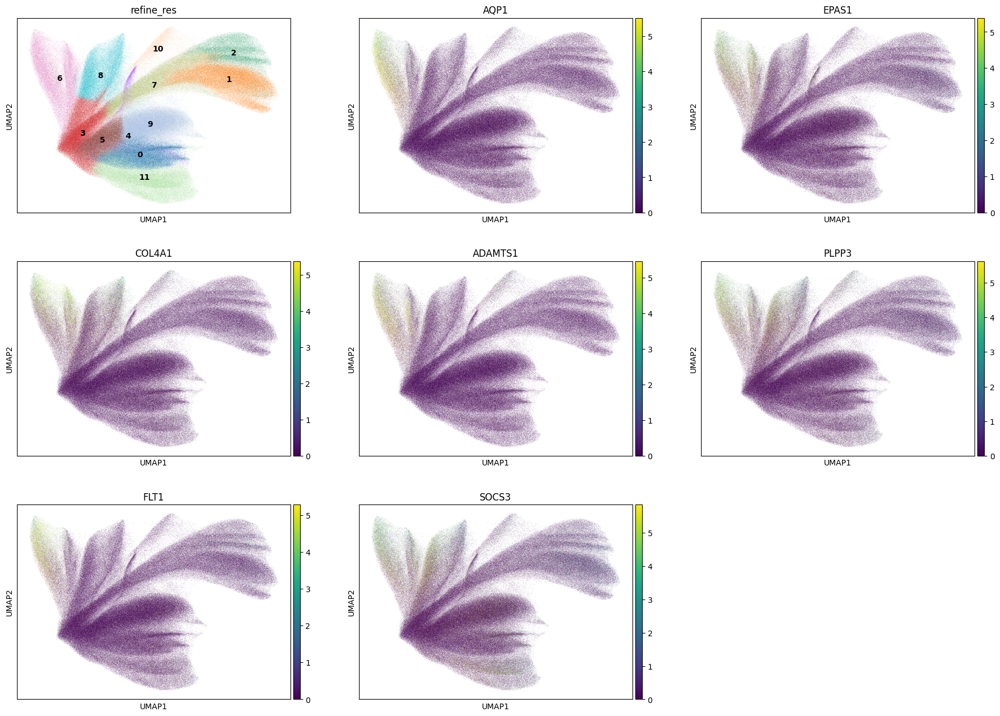

In [60]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [61]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 42961
Percentage of cells in cluster 6: 7.6


In [62]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.8. Cluster 7

In [63]:
cluster_id = '7'

In [64]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Breast_epithelial_cell,cancer_cell,61.3
1,Unknown,Unknown,normal_cell,28.8
2,NA,NA,NA,7.6
3,T,T,normal_cell,0.6
4,Fibroblast,CAF,normal_cell,0.5


In [65]:
top_ranked_genes[cluster_id]

0         XBP1
1    RAB11FIP1
2        H3F3B
3         CA12
4        HSPB1
5     SLC9A3R1
6        IL6ST
Name: 7, dtype: object

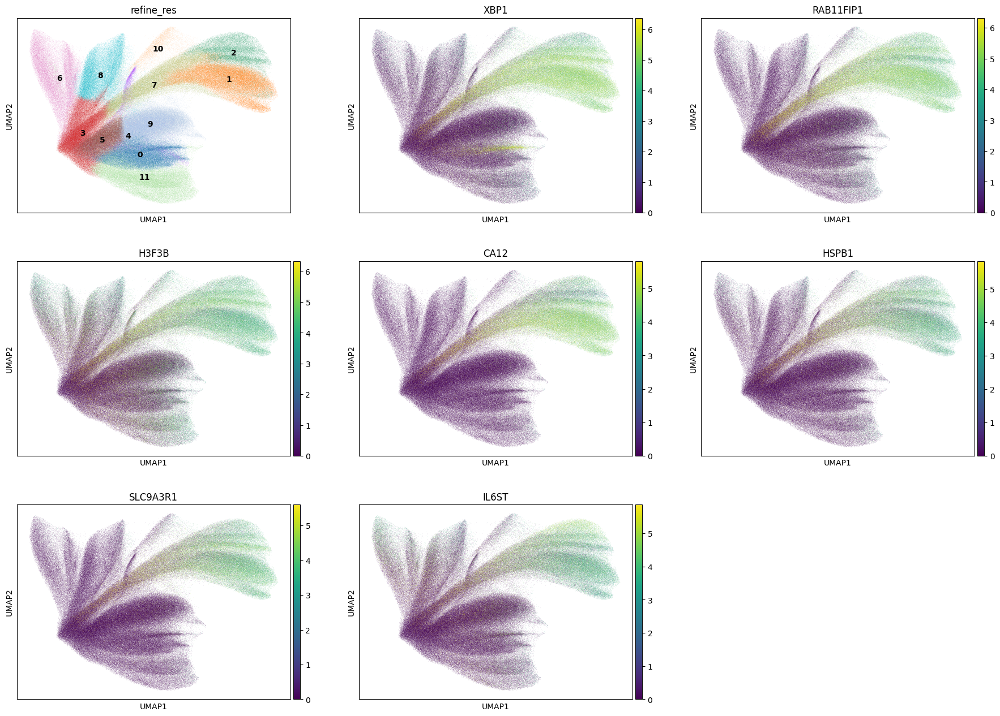

In [66]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [67]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 46801
Percentage of cells in cluster 7: 8.3


In [68]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Breast_epithelial_cell'

### 5.9. Cluster 8

In [69]:
cluster_id = '8'

In [70]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,81.6
1,Unknown,Unknown,normal_cell,4.2
2,Endothelial,Endothelial,normal_cell,3.9
3,NA,NA,NA,3.0
4,T,T,normal_cell,2.6


In [71]:
top_ranked_genes[cluster_id]

0       POSTN
1         DCN
2        CCL2
3         LUM
4       THBS1
5    SERPINE1
6       TIMP3
Name: 8, dtype: object

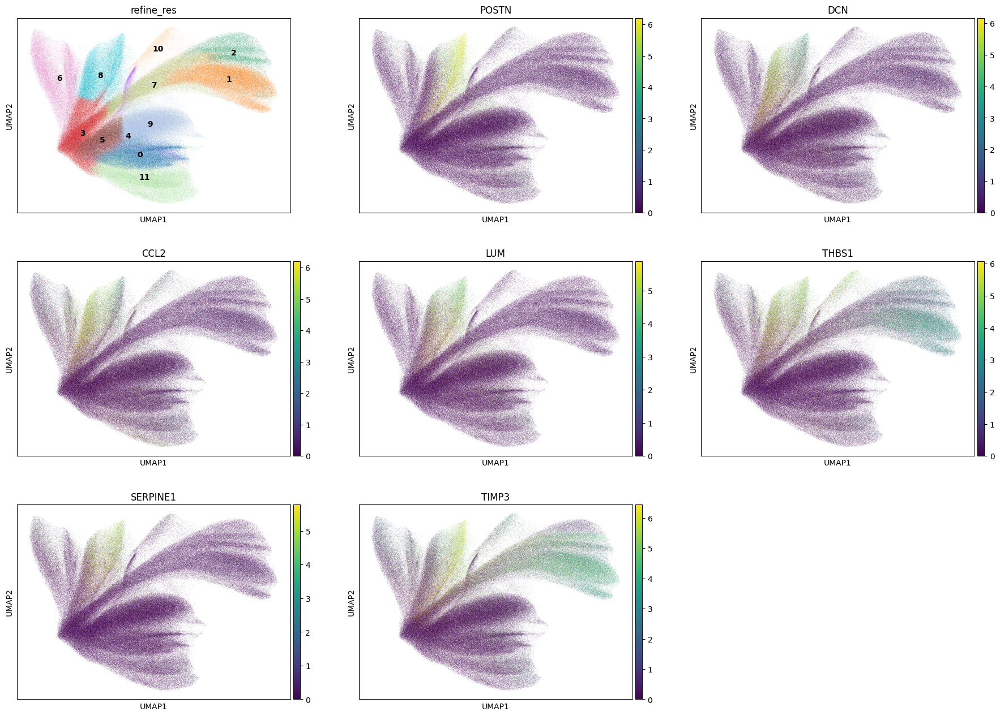

In [72]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [73]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 42889
Percentage of cells in cluster 8: 7.6


In [74]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.10. Cluster 9

In [75]:
cluster_id = '9'

In [76]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,82.9
1,Unknown,Unknown,normal_cell,9.9
2,Fibroblast,CAF,normal_cell,2.5
3,B,B,normal_cell,1.7
4,Plasma,Plasma,normal_cell,0.8


In [77]:
top_ranked_genes[cluster_id]

0     IL7R
1     TRAC
2    TRBC1
3    CXCR4
4    EEF1G
5     CD52
6    BIRC3
Name: 9, dtype: object

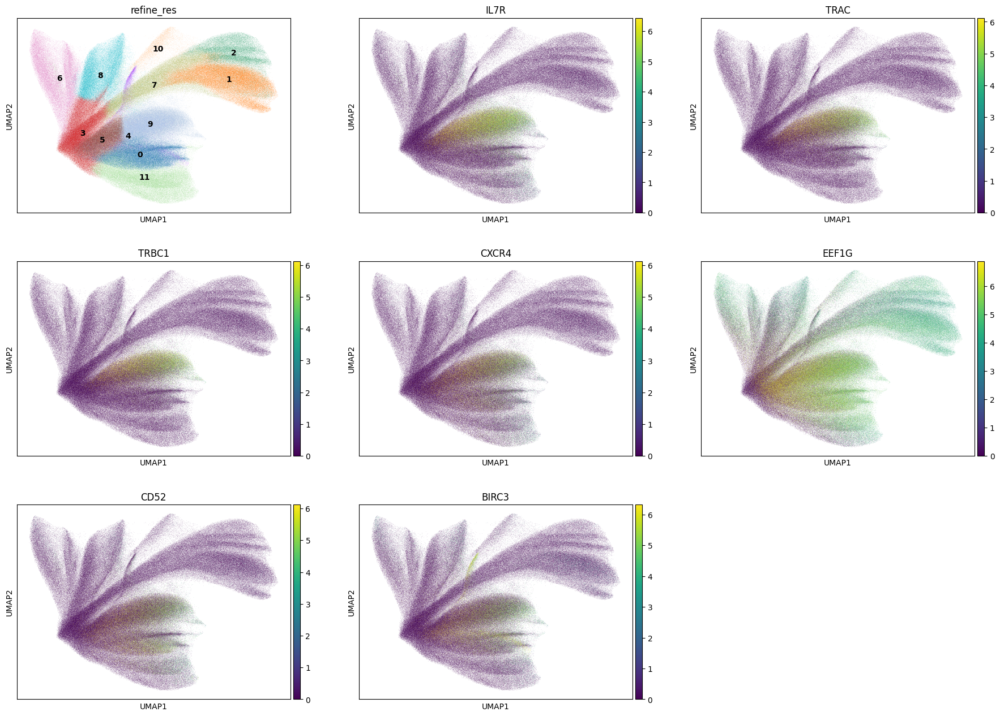

In [78]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [79]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 82523
Percentage of cells in cluster 9: 14.7


In [80]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.11. Cluster 10

In [81]:
cluster_id = '10'

In [82]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,Fibroblast,normal_cell,64.0
1,Epithelial,Breast_epithelial_cell,cancer_cell,16.9
2,Unknown,Unknown,normal_cell,11.0
3,NA,NA,NA,3.1
4,Fibroblast,CAF,normal_cell,2.2


In [83]:
top_ranked_genes[cluster_id]

0       DST
1     THBS1
2      MYL9
3     MYH11
4      MYLK
5    TRIM29
6      DSC3
Name: 10, dtype: object

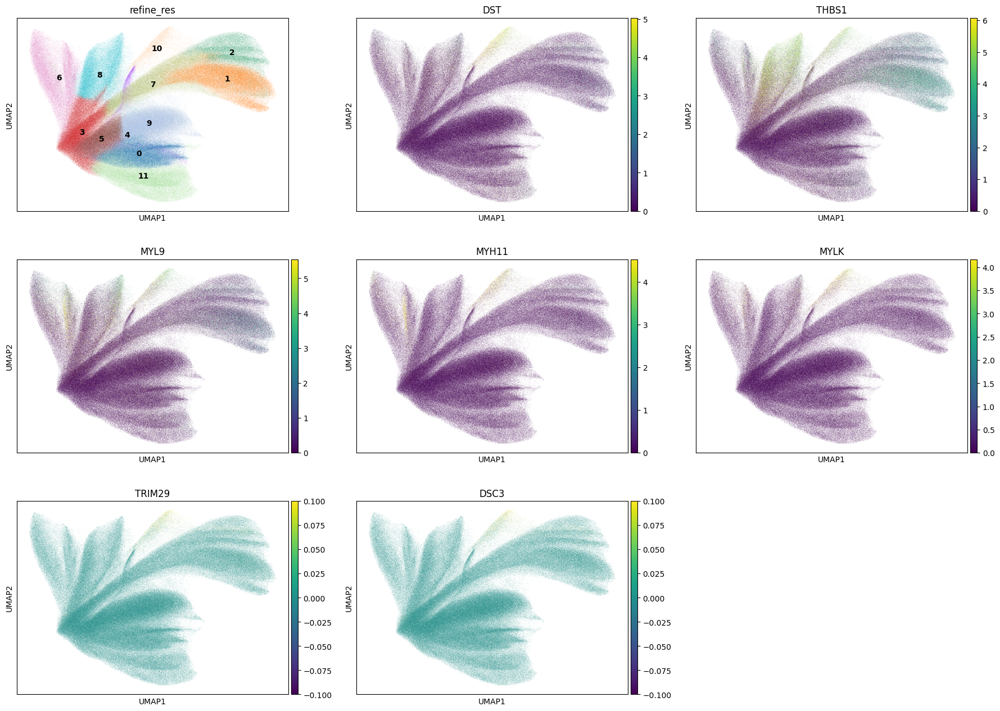

In [84]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [85]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 7559
Percentage of cells in cluster 10: 1.3


In [86]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Myofibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Myofibroblast'

### 5.12. Cluster 11

In [87]:
cluster_id = '11'

In [88]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,51.2
1,Unknown,Unknown,normal_cell,20.1
2,T,T,normal_cell,17.1
3,NA,NA,NA,6.7
4,Fibroblast,CAF,normal_cell,1.5


In [89]:
top_ranked_genes[cluster_id]

0      C1QC
1    MS4A6A
2     NAMPT
3      CTSL
4      AIF1
5    FCGR2A
6     C5AR1
Name: 11, dtype: object

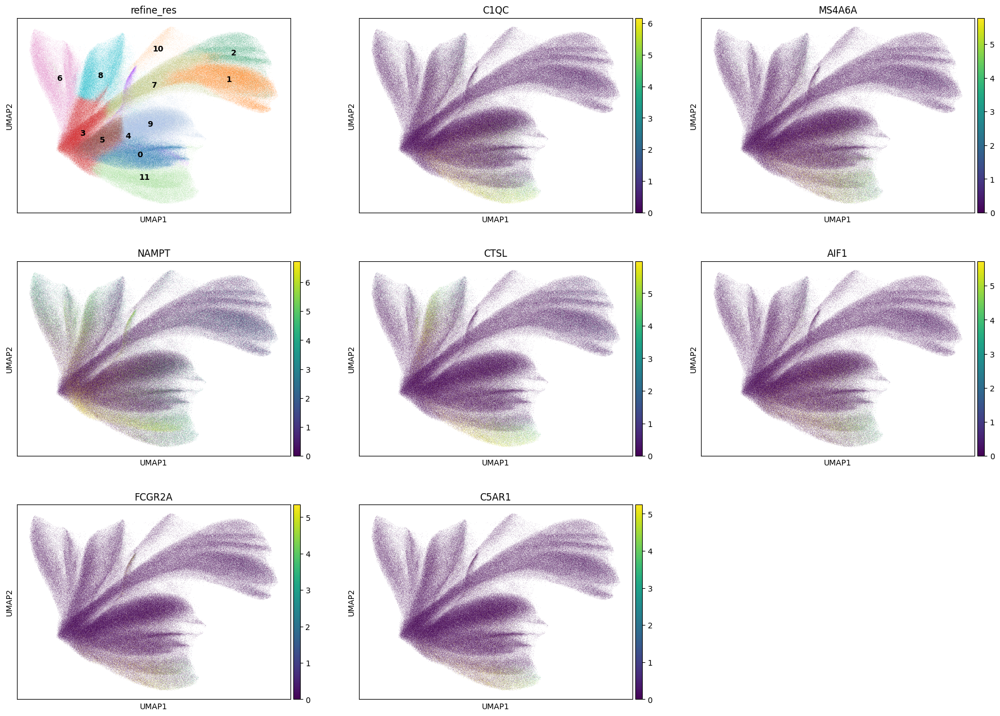

In [90]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [91]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 57529
Percentage of cells in cluster 11: 10.2


In [92]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

## 6. Cancer cells

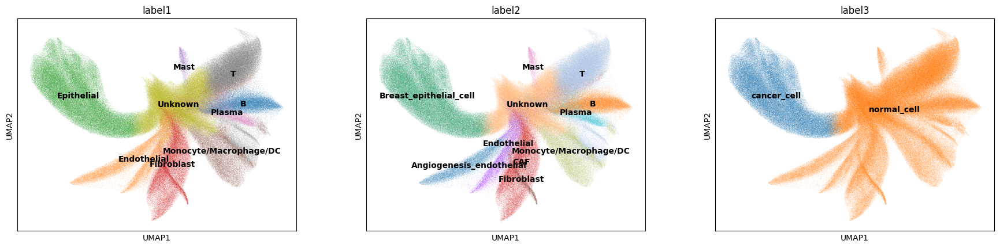

In [95]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

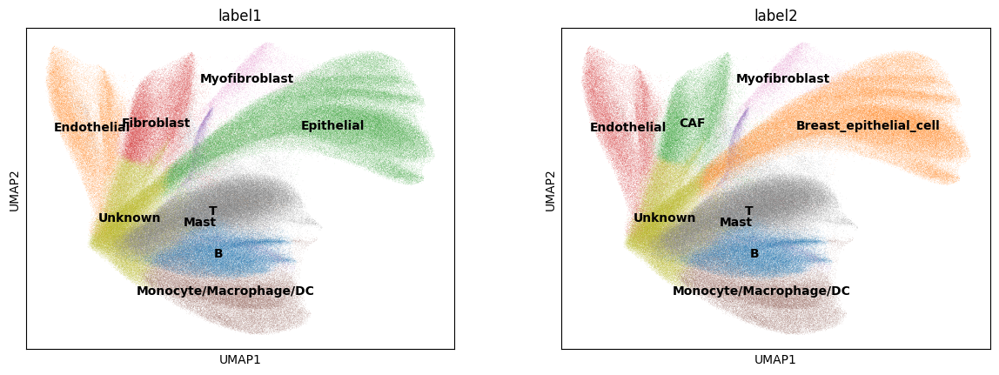

In [96]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [97]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Epithelial']), 'label3'] = 'cancer_cell'

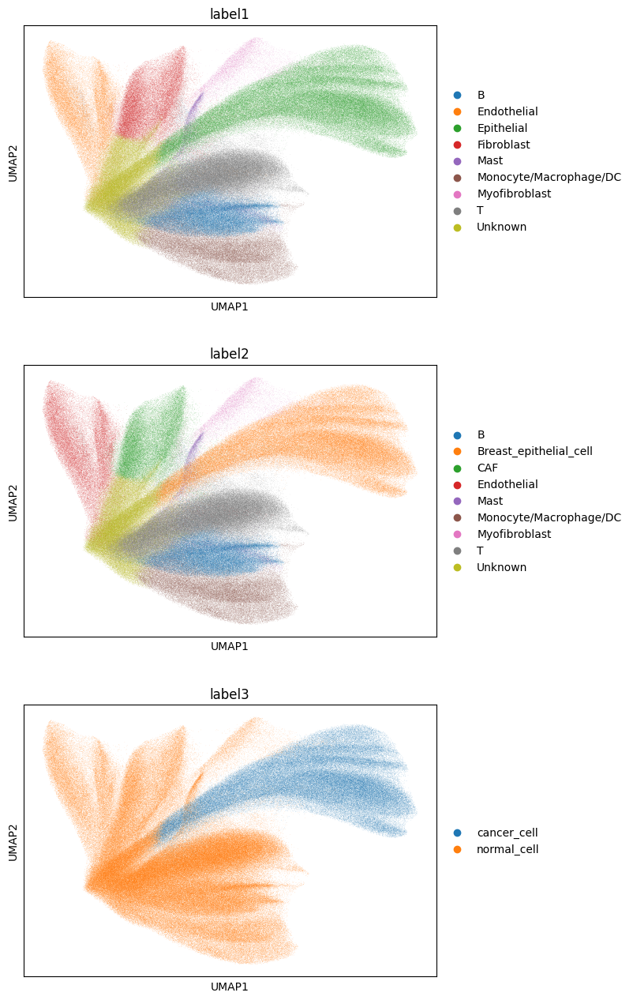

In [98]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [99]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,...,segmentation_method,region,z_level,pca_n20_pcs16_leiden_res0.2,pca_n20_pcs16_leiden_res0.4,pca_n20_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,557,0,0,0,0,89,646,220.723758,108.871723,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,0,1,1,1,Epithelial,Breast_epithelial_cell,cancer_cell
1,aaaaaaab-1,832,0,0,0,0,148,980,363.914232,91.892972,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,0,1,1,1,Epithelial,Breast_epithelial_cell,cancer_cell
2,aaaaaaac-1,544,0,0,0,0,119,663,181.392663,114.155004,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,0,1,1,1,Epithelial,Breast_epithelial_cell,cancer_cell
3,aaaaaaad-1,703,0,0,0,0,116,819,279.426885,81.010315,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,0,1,1,1,Epithelial,Breast_epithelial_cell,cancer_cell
4,aaaaaaae-1,207,0,0,0,0,30,237,75.094846,52.607033,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,0,1,1,1,Epithelial,Breast_epithelial_cell,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
699085,aaakiplp-1,18,0,0,0,0,10,28,49.852502,14.133907,...,Segmented by nucleus expansion of 5.0µm,cell_labels,9.0,1,5,3,3,Unknown,Unknown,normal_cell
699087,aaakipmb-1,12,0,0,0,0,7,19,32.015782,11.695469,...,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0,1,5,5,5,T,T,normal_cell
699088,aaakipmc-1,21,0,0,0,0,7,28,35.537970,10.611719,...,Segmented by nucleus expansion of 5.0µm,cell_labels,8.0,1,5,5,5,T,T,normal_cell
699091,aaakipmf-1,13,0,0,0,0,14,27,19.281719,19.281719,...,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0,1,5,5,5,T,T,normal_cell


In [100]:
adata_cells.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")